In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.feature_selection import SelectKBest, chi2, mutual_info_classif, VarianceThreshold
from sklearn.datasets import make_regression

import matplotlib.pyplot as plt
import seaborn as sns
import collections

from sklearn.neighbors import KNeighborsRegressor
from sklearn.neighbors import NearestNeighbors
from sklearn.tree import DecisionTreeRegressor
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.linear_model import RidgeCV
from sklearn.svm import LinearSVR
from sklearn.ensemble import StackingRegressor
from keras.models import Sequential
from keras.layers import Dense

from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
import time
from sklearn.metrics import accuracy_score

In [3]:
import pandas_profiling as ppf
train = pd.read_csv("../data/curated/match_house16_s.csv")
ppf.ProfileReport(train)

In [7]:
train.shape

(405, 21)

/Users/lijiayi/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='beds', ylabel='price'>

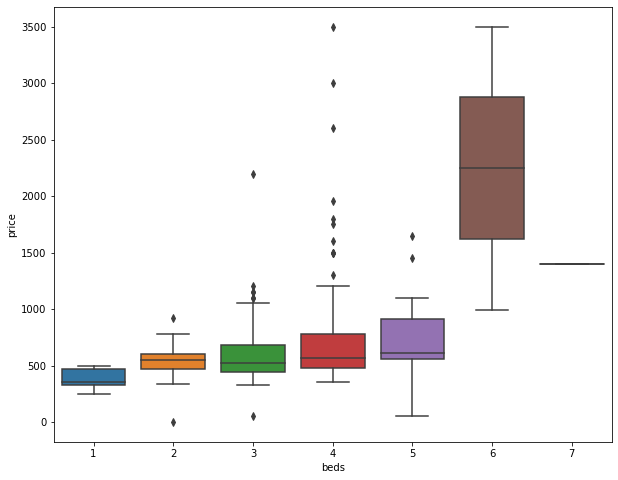

In [10]:
plt.figure(figsize=(10,8))
sns.boxplot(train.beds, train.price)

/Users/lijiayi/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='school', ylabel='price'>

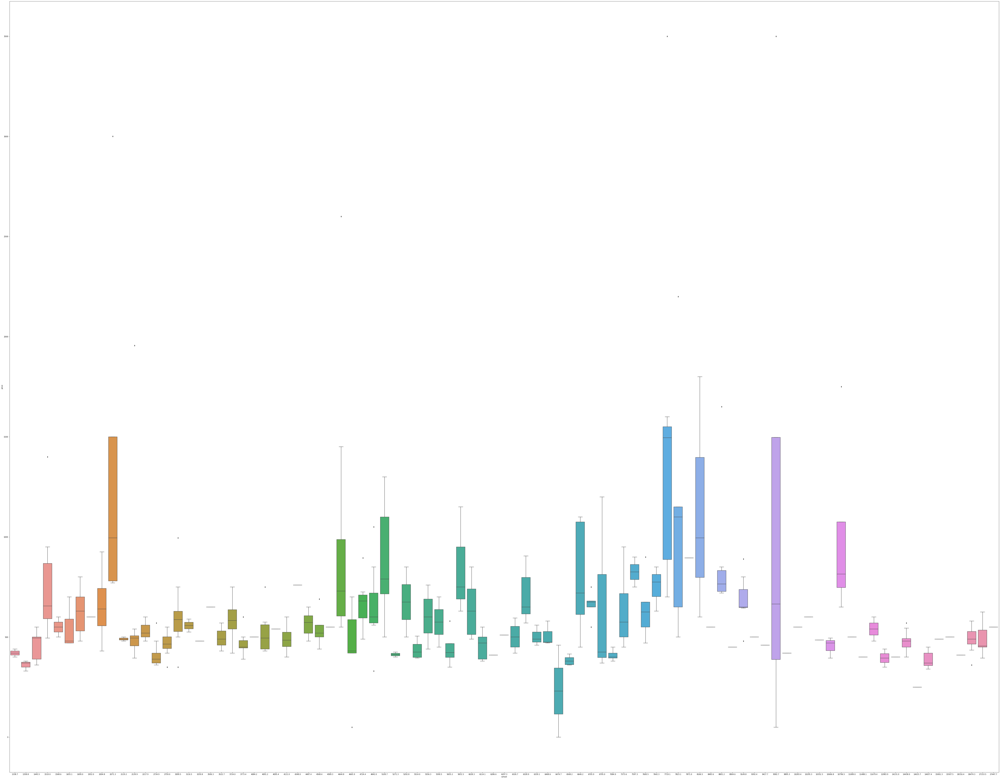

In [20]:
plt.figure(figsize=(100,80))
sns.boxplot(train.school, train.price)

/Users/lijiayi/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='train_station', ylabel='price'>

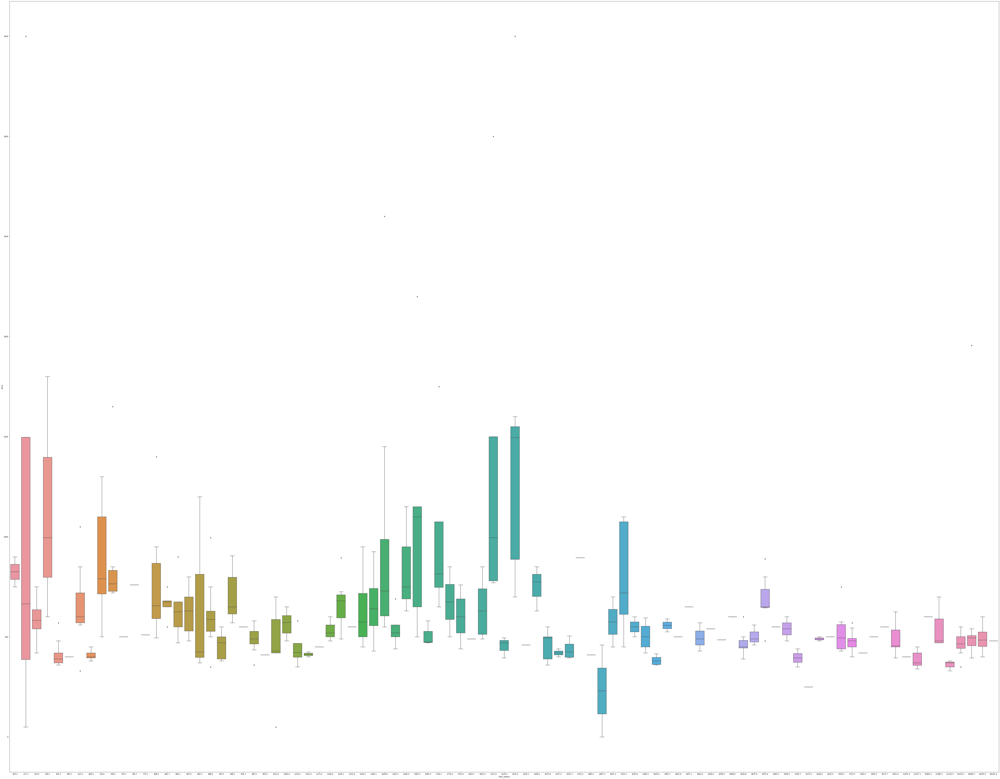

In [19]:
plt.figure(figsize=(100,80))
sns.boxplot(train.train_station, train.price)

Text(0, 0.5, 'Price')

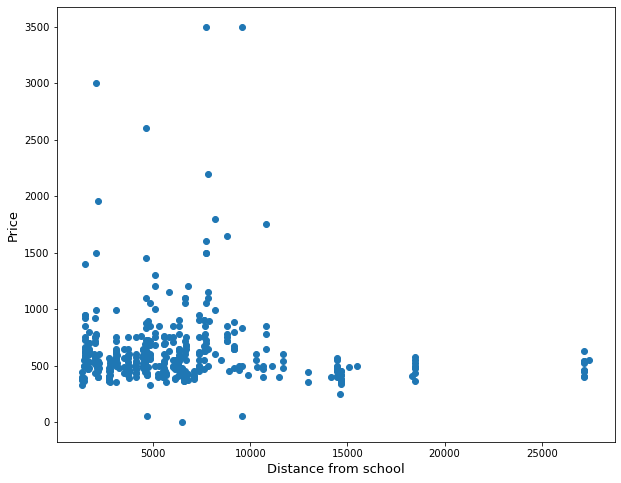

In [21]:
plt.figure(figsize=(10,8))
plt.scatter(x=train.school, y=train.price)
plt.xlabel("Distance from school", fontsize=13)
plt.ylabel("Price", fontsize=13)

Text(0, 0.5, 'Price')

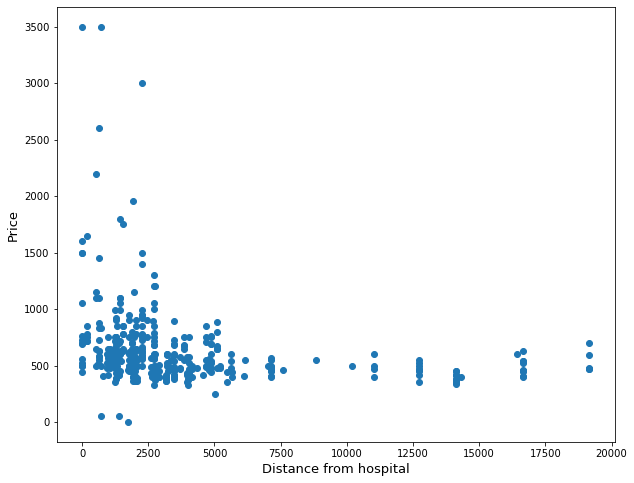

In [22]:
plt.figure(figsize=(10,8))
plt.scatter(x=train.hospital, y=train.price)  # find the linear relationship between variables
plt.xlabel("Distance from hospital", fontsize=13)
plt.ylabel("Price", fontsize=13)

Text(0, 0.5, 'Price')

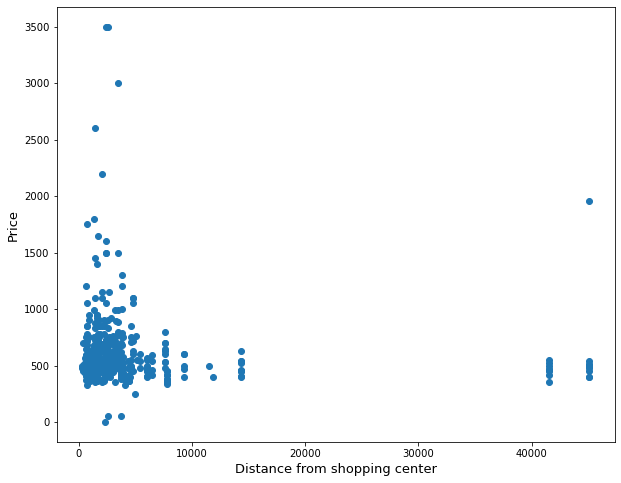

In [23]:
plt.figure(figsize=(10,8))
plt.scatter(x=train.shopping_center, y=train.price)
plt.xlabel("Distance from shopping center", fontsize=13)
plt.ylabel("Price", fontsize=13)

In [ ]:
plt.figure(figsize=(100,80))
sns.boxplot(train.park, train.price)

/Users/lijiayi/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='park', ylabel='price'>

/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='fitness_gym', ylabel='price'>

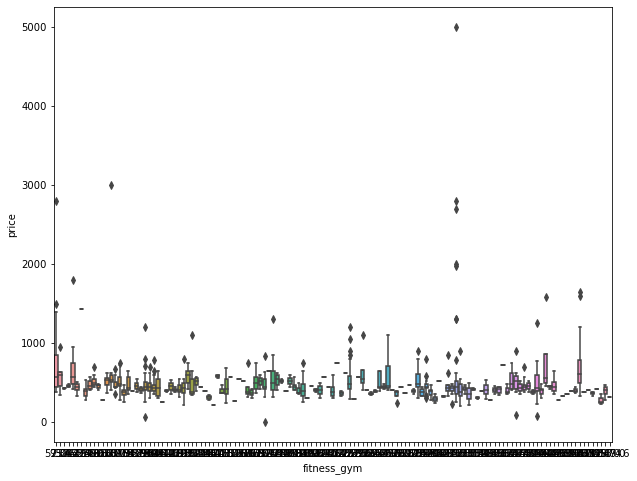

In [33]:
plt.figure(figsize=(100,8))
sns.boxplot(train.fitness_gym, train.price)

/opt/anaconda3/lib/python3.9/site-packages/seaborn/axisgrid.py:1242: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=figsize)


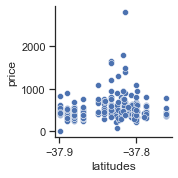

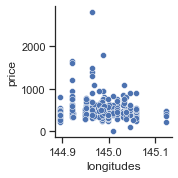

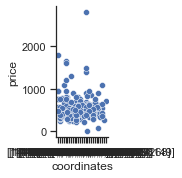

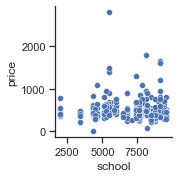

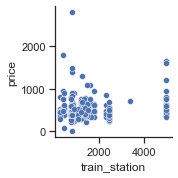

...

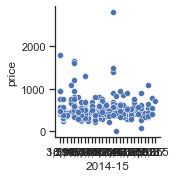

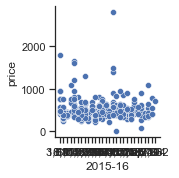

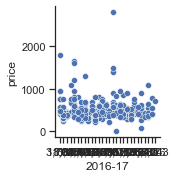

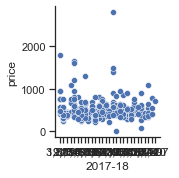

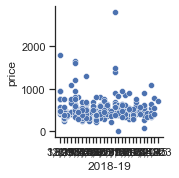

In [62]:
sns.set(style="ticks", color_codes=True)
for i in range(9,33):
    sns.pairplot(train, x_vars=train.columns.values[i:i+1], y_vars="price")
plt.show()

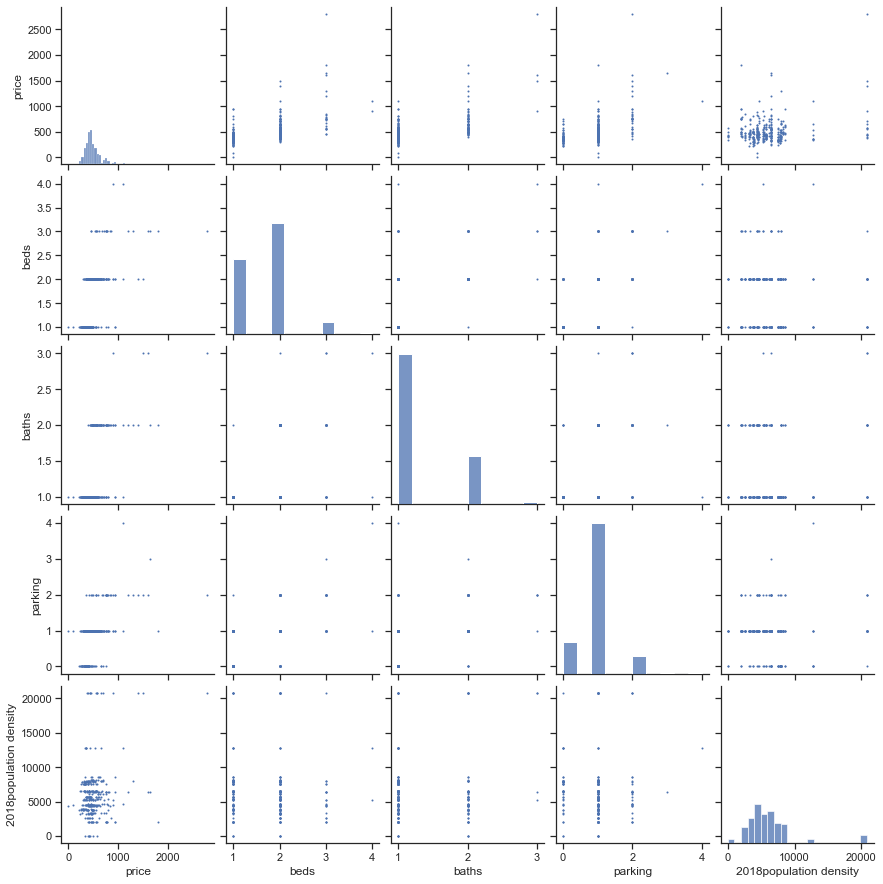

In [63]:
import matplotlib.pyplot as plt
from statsmodels.formula.api import ols
pd.options.mode.chained_assignment = None
sns.set(style="ticks", color_codes=True)
g = sns.pairplot(train[['price','beds','baths','parking','2018population density']], plot_kws=dict(s=1, edgecolor="b", linewidth=1),)

<AxesSubplot:>

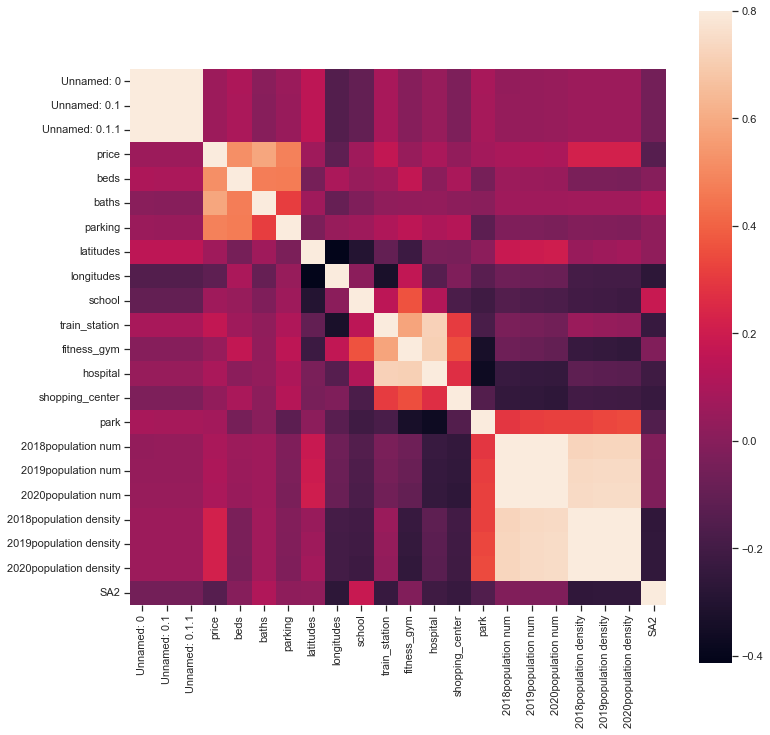

In [64]:
corrmat = train.corr()
corrmat.sort_values('price',ascending=False).index
f, ax = plt.subplots(figsize=(12, 12))
sns.heatmap(corrmat, vmax=.8, square=True)

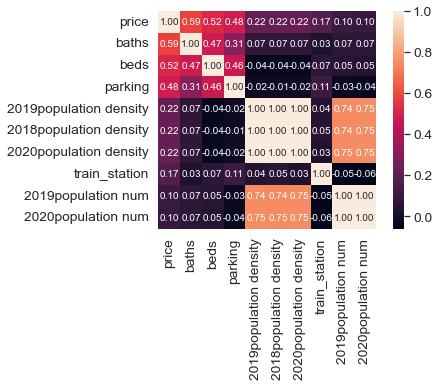

In [66]:
#saleprice correlation matrix
k = 10 # number of variables for heatmap
cols = corrmat.nlargest(k, 'price')['price'].index
cm = np.corrcoef(train[cols].values.T)
sns.set(font_scale=1.25)
hm = sns.heatmap(cm, cbar=True, annot=True, square=True, fmt='.2f', annot_kws={'size': 10}, yticklabels=cols.values, xticklabels=cols.values)
plt.show()

In [67]:
print(corrmat.sort_values('price',ascending=False).index)

Index(['price', 'baths', 'beds', 'parking', '2019population density',
       '2018population density', '2020population density', 'train_station',
       '2019population num', '2020population num', '2018population num',
       'hospital', 'park', 'latitudes', 'school', 'Unnamed: 0', 'Unnamed: 0.1',
       'Unnamed: 0.1.1', 'fitness_gym', 'shopping_center', 'longitudes',
       'SA2'],
      dtype='object')


In [68]:
train['price'].describe()

count     348.000000
mean      508.735632
std       241.670124
min         0.000000
25%       393.750000
50%       450.000000
75%       550.000000
max      2800.000000
Name: price, dtype: float64

Skewness: 4.125224
Kurtosis: 28.314997


/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


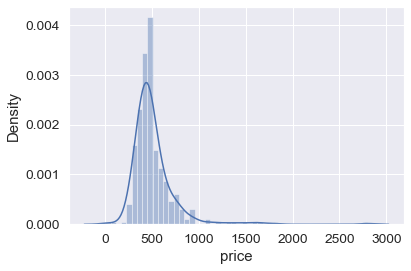

In [69]:
sns.distplot(train['price'])
print("Skewness: %f" % train['price'].skew())
print("Kurtosis: %f" % train['price'].kurt())

It is evident that the distribution of the data is similar to the normal distribution, but the "normal distribution" is a left-skewed normal distribution. In order to measure the degree of skewness of the value, we measure the kurtosis and skewness. The peak state of distribution is steep (high tip) since kurtosis is larger than 0. At the same time, the larger the absolute value of skewness, the more serious the deviation degree of distribution. For a more normally distributed plot, we do a log transformation.

/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


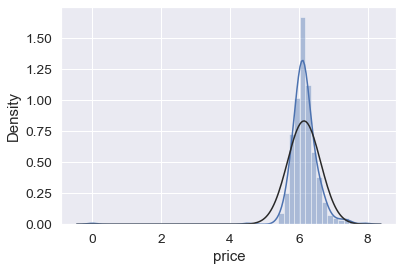

In [70]:
from scipy.stats import norm
train["price"] = np.log1p(train["price"])
sns.distplot(train['price'],fit=norm );

In above figure, the black line is the normal distribution curve, and the blue line is the fitted curve. And we can see that the skewness has been corrected and the data look more normally distributed.

array([[<AxesSubplot:title={'center':'Unnamed: 0'}>,
        <AxesSubplot:title={'center':'Unnamed: 0.1'}>,
        <AxesSubplot:title={'center':'Unnamed: 0.1.1'}>,
        <AxesSubplot:title={'center':'price'}>,
        <AxesSubplot:title={'center':'beds'}>],
       [<AxesSubplot:title={'center':'baths'}>,
        <AxesSubplot:title={'center':'parking'}>,
        <AxesSubplot:title={'center':'latitudes'}>,
        <AxesSubplot:title={'center':'longitudes'}>,
        <AxesSubplot:title={'center':'school'}>],
       [<AxesSubplot:title={'center':'train_station'}>,
        <AxesSubplot:title={'center':'fitness_gym'}>,
        <AxesSubplot:title={'center':'hospital'}>,
        <AxesSubplot:title={'center':'shopping_center'}>,
        <AxesSubplot:title={'center':'park'}>],
       [<AxesSubplot:title={'center':'2018population num'}>,
        <AxesSubplot:title={'center':'2019population num'}>,
        <AxesSubplot:title={'center':'2020population num'}>,
        <AxesSubplot:title={'center'

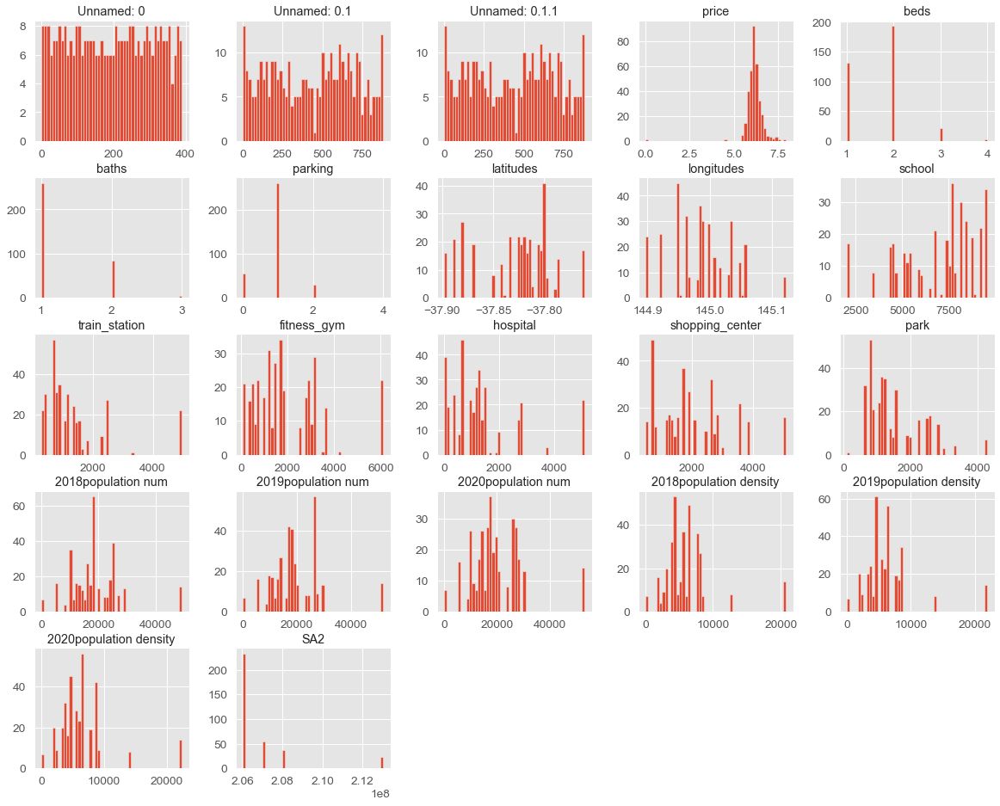

In [76]:
# draw bar charts for each numerical attribute
%matplotlib inline
from matplotlib import pyplot as plt
plt.style.use('ggplot')
train.hist(bins=50,figsize=(20,16))

xgboost https://xgboost.readthedocs.io/en/stable/python/python_intro.html

In [4]:
import xgboost as xgb
import scipy
data = np.random.rand(5, 10)  # 5 entities, each contains 10 features
label = np.random.randint(2, size=5)  # binary target
dtrain = xgb.DMatrix(data, label=label)
csr = scipy.sparse.csr_matrix((dat, (row, col)))
dtrain = xgb.DMatrix(csr)
data = pandas.DataFrame(np.arange(12).reshape((4,3)), columns=['a', 'b', 'c'])
label = pandas.DataFrame(np.random.randint(2, size=4))
dtrain = xgb.DMatrix(data, label=label)
dtrain = xgb.DMatrix('train.svm.txt')
dtrain.save_binary('train.buffer')
dtrain = xgb.DMatrix(data, label=label, missing=np.NaN)
w = np.random.rand(5, 1)
dtrain = xgb.DMatrix(data, label=label, missing=np.NaN, weight=w)
dtrain = xgb.DMatrix('train.svm.txt')
dtest = xgb.DMatrix('test.svm.buffer')
# label_column specifies the index of the column containing the true label
dtrain = xgb.DMatrix('train.csv?format=csv&label_column=0')
dtest = xgb.DMatrix('test.csv?format=csv&label_column=0')
param = {'max_depth': 2, 'eta': 1, 'objective': 'binary:logistic'}
param['nthread'] = 4
param['eval_metric'] = 'auc'
param['eval_metric'] = ['auc', 'ams@0']

# alternatively:
# plst = param.items()
# plst += [('eval_metric', 'ams@0')]
evallist = [(dtest, 'eval'), (dtrain, 'train')]
# train
num_round = 10
bst = xgb.train(param, dtrain, num_round, evallist)
bst.save_model('0001.model')
# dump model
bst.dump_model('dump.raw.txt')
# dump model with feature map
bst.dump_model('dump.raw.txt', 'featmap.txt')
bst = xgb.Booster({'nthread': 4})  # init model
bst.load_model('model.bin')  # load data
train(..., evals=evals, early_stopping_rounds=10)
# 7 entities, each contains 10 features
data = np.random.rand(7, 10)
dtest = xgb.DMatrix(data)
ypred = bst.predict(dtest)
ypred = bst.predict(dtest, iteration_range=(0, bst.best_iteration + 1))
xgb.plot_importance(bst)
xgb.to_graphviz(bst, num_trees=2)
# Use "gpu_hist" for training the model.
reg = xgb.XGBRegressor(tree_method="gpu_hist")
# Fit the model using predictor X and response y.
reg.fit(X, y)
# Save model into JSON format.
reg.save_model("regressor.json")

Split set

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X_train, Y_train, 
                                                            test_size = 0.33,  random_state = 42, shuffle = False)

KNN

In [ ]:
neigh = KNeighborsRegressor(n_neighbors=2)
neigh.fit(trainX, trainy)
print(neigh.predict(trainX))

# NN
neigh = NearestNeighbors(n_neighbors=1)
neigh.fit(samples)
NearestNeighbors(n_neighbors=1)

LR

In [ ]:
lr = LogisticRegression(solver = 'sag', multi_class = 'multinomial', C = 0.8, max_iter = 200).fit(trainX, trainY)
y_train_predicted = lr.predict(trainX)
clf.predict_proba(trainX)
#print("Training accuracy:" , np.mean(y_train_predicted == trainY))
clf.predict(trainX)
clf.score(trainX, trainY)

Decision Tree

In [ ]:
regressor = DecisionTreeRegressor(random_state=0)
cross_val_score(regressor, train_X, train_y, cv=10)

Random Forest

In [ ]:
X, y = make_regression(n_features=4, n_informative=2, random_state=0, shuffle=False)
regr = RandomForestRegressor(max_depth=2, random_state=0)
regr.fit(X, y)
print(regr.predict([[0, 0, 0, 0]]))

neural network

In [ ]:
X, y = make_regression(n_samples=200, random_state=1)
X_train, X_test, y_train, y_test = train_test_split(X, y,random_state=1)
regr = MLPRegressor(random_state=1, max_iter=500).fit(X_train, y_train)
regr.predict(X_test[:2])
array([-0.9..., -7.1...])
regr.score(X_test, y_test)

Stacking

In [ ]:
X, y = load_diabetes(return_X_y=True)
estimators = [ ('lr', RidgeCV()), ('svr', LinearSVR(random_state=42))]
reg = StackingRegressor(estimators=estimators, final_estimator=RandomForestRegressor(n_estimators=10, random_state=42))
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42)
reg.fit(X_train, y_train).score(X_test, y_test)

ANN

https://thinkingneuron.com/using-artificial-neural-networks-for-regression-in-python/

In [ ]:
# create ANN model
model = Sequential()
# Defining the Input layer and FIRST hidden layer, both are same!
model.add(Dense(units=5, input_dim=7, kernel_initializer='normal', activation='relu'))
# Defining the Second layer of the model
# after the first layer we don't have to specify input_dim as keras configure it automatically
model.add(Dense(units=5, kernel_initializer='normal', activation='tanh'))
# The output neuron is a single fully connected node 
# Since we will be predicting a single number
model.add(Dense(1, kernel_initializer='normal'))
# Compiling the model
model.compile(loss='mean_squared_error', optimizer='adam')
# Fitting the ANN to the Training set
model.fit(X_train, y_train ,batch_size = 20, epochs = 50, verbose=1)

https://stackoverflow.com/questions/49008074/how-to-create-a-neural-network-for-regression

In [ ]:
from keras.layers import Dense, Activation
from keras.models import Sequential
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
# Importing the dataset
dataset = np.genfromtxt("data.txt", delimiter='')
X = dataset[:, :-1]
y = dataset[:, -1]
# Splitting the dataset into the Training set and Test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.08, random_state = 0)

# Feature Scaling
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

# Initialising the ANN
model = Sequential()

# Adding the input layer and the first hidden layer
model.add(Dense(32, activation = 'relu', input_dim = 6))

# Adding the second hidden layer
model.add(Dense(units = 32, activation = 'relu'))

# Adding the third hidden layer
model.add(Dense(units = 32, activation = 'relu'))

# Adding the output layer

model.add(Dense(units = 1))

#model.add(Dense(1))
# Compiling the ANN
model.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Fitting the ANN to the Training set
model.fit(X_train, y_train, batch_size = 10, epochs = 100)

y_pred = model.predict(X_test)

plt.plot(y_test, color = 'red', label = 'Real data')
plt.plot(y_pred, color = 'blue', label = 'Predicted data')
plt.title('Prediction')
plt.legend()
plt.show()

### Confusion Matrix from project 1

In [3]:
import matplotlib.pyplot as plt
from statsmodels.formula.api import ols
import seaborn as sns
pd.options.mode.chained_assignment = None

In [ ]:
sns.set(style="ticks", color_codes=True)
g = sns.pairplot(df_merge[['new_test','new_pos','cumulative_pos','total_income']], plot_kws=dict(s=1, edgecolor="b", linewidth=1),)

### heatmap
https://zhuanlan.zhihu.com/p/96040773

In [ ]:
import seaborn as sns
%matplotlib inline
sns.set(font_scale=1.5)

In [ ]:
#导入数据集后按年月两个维度进行数据透视
data=sns.load_dataset("flights")\
        .pivot("month","year","passengers") 
data.head()

In [ ]:
sns.set_context({"figure.figsize":(8,8)})
sns.heatmap(data=data,square=True) 
#可以看到热力图主要展示的是二维数据的数据关系
#不同大小的值对应不同的颜色深浅

vmax：设置颜色带的最大值
vmin：设置颜色带的最小值

In [ ]:
sns.heatmap(data=data,vmin=200,vmax=500)

In [ ]:

#cmap：设置颜色带的色系

sns.heatmap(data=data,cmap="RdBu_r")

#annot：是否显示数值注释

sns.heatmap(data=data,annot=True,cmap="RdBu_r")

#fmt：format的缩写，设置数值的格式化形式

sns.heatmap(data=data,annot=True,fmt="d",cmap="RdBu_r")
#foramt为int类型